# AI Music Generator
## The Question
As a group of music enthusiasts, we were inspired by the concept of Natural Language Processing (NLP) given in the lecture. One of the key takeaways from our studies was that AI can learn patterns and generate meaningful outputs based on training data. This concept became even more intriguing after our paper presentation on BERT, where we saw how AI can generate coherent text.

This led us to an interesting realization. **Can AI generate music?**

## The Data
We love Jazz music and we choose to use the data from [Jazzomat Weimar](https://jazzomat.hfm-weimar.de/download/download.html), which includes 434 jazz solo from various musicians in midi files format and [JazzVAR](https://zenodo.org/records/11264676), which includes 505 jazz standards (classic songs) all in C Major/A minor.

A MIDI file is a specialized format that records musical compositions in the time domain. It captures musical events such as when a specific note (e.g., C) is played at a particular timestamp (X) and when it stops at another timestamp (Y).

We trained our model on the two different datasets mentioned above, and it is fascinating to see how significantly the generated results differ.
## The Approcah
Through the lectrues and those good paper presentations.
We've known that we need to use some methods that can handle sequential data. So LSTM is excatly what we needed. We will use LSTM to generate music to see whether the AI can remember some music patterns.
## Our Hypothesis
Music, much like language, follows structured rules. In English, there are grammar, while in music, there are theoretical constraints (e.g., classical music often avoids tritones due to their dissonance but jazz music use tritones a LOT). Since AI has proven effective in text generation by understanding and learning linguistic patterns, we hypothesize that AI might also be capable of generating music by learning musical structures.
## Why Bother?
Writing and the arts are often considered uniquely human capabilities. If AI can perform these tasks, does that imply AI is equivalent to humans?

Furthermore, if AI can learn music—a structured language—it strengthens the possibility that AI can learn other structured systems, such as DNA sequences, programming languages, and even human cognition patterns. This opens up new opportunities to explore the world and push the boundaries of AI technology.


## Basic Setup


### Get the code
We have already developed the core code, allowing us to keep the Jupyter Notebook clean and focused. This makes the demo easier to follow and ensures smooth execution. Now, we can integrate the code into the notebook for testing and visualization.

In [1]:
!git clone https://github.com/MorrisHohoho/AI_Music_Generator.git

Cloning into 'AI_Music_Generator'...
remote: Enumerating objects: 595, done.
remote: Counting objects: 100% (595/595), done.
remote: Compressing objects: 100% (237/237), done.
remote: Total 595 (delta 356), reused 595 (delta 356), pack-reused 0 (from 0)
Receiving objects: 100% (595/595), 25.39 MiB | 11.40 MiB/s, done.
Resolving deltas: 100% (356/356), done.


### Get the toolkit
Next, we need to download essential toolkits for our project. There are many dependencies, but they serve similar purposes, such as parsing MIDI files, converting MIDI to CSV and vice versa, and handling audio dependencies for converting MIDI to audio.

### Get the framework
We chose PyTorch as our ML framework because it is widely used, fast, powerful, and easy to understand. It is commonly seen in a lot of projects. Since PyTorch is pre-installed in Colab, we don't need to worry about installation.

In [2]:
!apt-get update -qq && apt-get install -qq fluidsynth fluid-soundfont-gm midicsv
!pip install pretty_midi mido midi2audio fluidsynth pyfluidsynth mir_eval

W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Extracting templates from packages: 100%
Selecting previously unselected package libqt5core5a:amd64.
(Reading database ... 125044 files and directories currently installed.)
Preparing to unpack .../00-libqt5core5a_5.15.3+dfsg-2ubuntu0.2_amd64.deb ...
Unpacking libqt5core5a:amd64 (5.15.3+dfsg-2ubuntu0.2) ...
Selecting previously unselected package libevdev2:amd64.
Preparing to unpack .../01-libevdev2_1.12.1+dfsg-1_amd64.deb ...
Unpacking libevdev2:amd64 (1.12.1+dfsg-1) ...
Selecting previously unselected package libmtdev1:amd64.
Preparing to unpack .../02-libmtdev1_1.1.6-1build4_amd64.deb ...
Unpacking libmtdev1:amd64 (1.1.6-1build4) ...
Selecting previously unselected package libgudev-1.0-0:amd64.
Preparing to unpack .../03-libgudev-1.0-0_1%3a237-2build1_amd64.deb ...
Unpacking libgudev-1.0-0:amd64 (

### Get the data
We can download the data directly from [Jazzomat Weimar](https://jazzomat.hfm-weimar.de/download/download.html)/[Jazzvar](https://zenodo.org/records/11264676). Here we take the Jazzomat Weimar as an example.

In [3]:
!wget https://jazzomat.hfm-weimar.de/download/downloads/RELEASE2.0_mid_unquant.zip
!unzip RELEASE2.0_mid_unquant.zip -d music_data

--2025-03-15 00:04:42--  https://jazzomat.hfm-weimar.de/download/downloads/RELEASE2.0_mid_unquant.zip
Resolving jazzomat.hfm-weimar.de (jazzomat.hfm-weimar.de)... 141.54.193.13
Connecting to jazzomat.hfm-weimar.de (jazzomat.hfm-weimar.de)|141.54.193.13|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1345859 (1.3M) [application/zip]
Saving to: ‘RELEASE2.0_mid_unquant.zip’

RELEASE2.0_mid_unqu 100%[===================>]   1.28M  1.33MB/s    in 1.0s    

2025-03-15 00:04:44 (1.33 MB/s) - ‘RELEASE2.0_mid_unquant.zip’ saved [1345859/1345859]

Archive:  RELEASE2.0_mid_unquant.zip
  inflating: music_data/ArtPepper_Anthropology_FINAL.mid  
  inflating: music_data/ArtPepper_BluesForBlanche_FINAL.mid  
  inflating: music_data/ArtPepper_Desafinado_FINAL.mid  
  inflating: music_data/ArtPepper_InAMellowTone_FINAL.mid  
  inflating: music_data/ArtPepper_Stardust-1_FINAL.mid  
  inflating: music_data/ArtPepper_Stardust-2_FINAL.mid  
  inflating: music_data/BennyCarter_IGotI

### Load Packages
Here, we load the essential Python packages needed for our project.

In [4]:
import os
import torch
# Midi to audio and play!
from IPython.display import Audio
from midi2audio import FluidSynth

import pretty_midi
import numpy as np
# For plotting
import mir_eval.display
import librosa.display
import matplotlib.pyplot as plt
%matplotlib inline
# For putting audio in the notebook
import IPython.display
# For object serilizing
import pickle

os.chdir('AI_Music_Generator') # Change the working directory in our code repos.
# Our developed core logic
from model.LSTM import LSTM
from generate import *




## Data Processing

### Dataset Skim
Let's explore the dataset and see what it contains.

In [5]:
dataset_path = "../music_data"
res = os.listdir(dataset_path)
print(len(res))
print(res[:10])

456
['KennyDorham_Punjab_FINAL.mid', 'JohnnyDodds_OnceInAWhile_FINAL.mid', 'WarneMarsh_Wow-1_FINAL.mid', 'ChetBaker_ThereWillNeverBeAnotherYou-1_FINAL.mid', 'CharlieParker_ScrappleFromTheApple_FINAL.mid', 'EricDolphy_245_FINAL.mid', "JJJohnson_Walkin'_FINAL.mid", 'DavidLiebman_Pendulum_FINAL.mid', 'PhilWoods_CottonTail_FINAL.mid', 'DonEllis_YouSteppedOutOfADream-2_FINAL.mid']


So, we have different MIDI files, each representing a song composed by different musicians. Let's take a look at the structure of a MIDI file and listen to how it sounds.

In [6]:
# This code is directly from the pretty_midi official tutorial
def plot_piano_roll(pm, start_pitch, end_pitch, fs=100):
    # Use librosa's specshow function for displaying the piano roll
    librosa.display.specshow(pm.get_piano_roll(fs)[start_pitch:end_pitch],
                             hop_length=1, sr=fs,
                             x_axis='time', y_axis='cqt_note',
                             fmin=pretty_midi.note_number_to_hz(start_pitch))

<ipython-input-6-18f400e92ad4>:4: UserWarning: Frequency axis exceeds Nyquist. Did you remember to set all spectrogram parameters in specshow?
  librosa.display.specshow(pm.get_piano_roll(fs)[start_pitch:end_pitch],


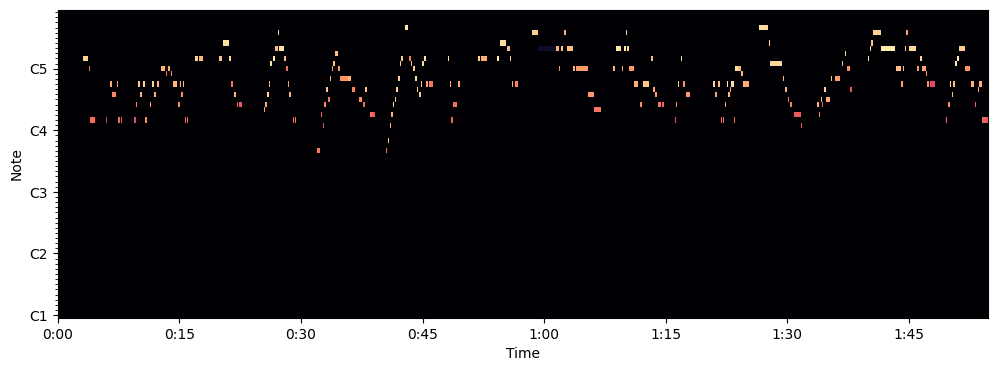

In [7]:
midi_file_path = os.path.join(dataset_path,'MilesDavis_SoWhat_FINAL.mid')
pm = pretty_midi.PrettyMIDI(midi_file_path)
plt.figure(figsize=(12,4))
plot_piano_roll(pm,24,84)

In [8]:
# Covert MIDI to WAV
fs = FluidSynth()
fs.midi_to_audio(midi_file_path,"temp.wav")
Audio("temp.wav")


As we can see, a MIDI file is just a sequence of time-stamped musical events. This means we can train a model to generate similar sequences.

Now, we need to process the data to convert it into a machine-understandable format that can be used for training.

### Prepare the data
To acheive this, we choose to use [midicsv](https://www.fourmilab.ch/webtools/midicsv/), which allows us to convert MIDI files to CSV format and back. This helps in processing and structuring the data for our model.


In [10]:
c = 0
with open('csv/jazzomat_csv/SteveLacy_Work_FINAL.csv','r') as f:
    for line in f:
      if c >=10:
        break
      print(line)
      c += 1

0, 0, Header, 1, 1, 192

1, 0, Start_track

1, 0, Title_t, "Melody"

1, 0, Tempo, 359281

1, 0, Time_signature, 4, 2, 24, 8

1, 5308, Note_on_c, 0, 68, 117

1, 5397, Note_off_c, 0, 68, 117

1, 5688, Note_on_c, 0, 63, 119

1, 5790, Note_off_c, 0, 63, 119

1, 5803, Note_on_c, 0, 62, 118



### Dataset Explanation
The CSV file contains metadata such as the number of tracks, tempo, and key signature, along with detailed note information.

For example,
```
1, 5308, Note_on_c, 0, 68, 117
1, 5397, Note_off_c, 0, 68, 117
```
This means note 68 (G#4) starts at time 5308 and ends at time 5397.
For convenience, we have pre-converted all MIDI files and included the processed data in our GitHub repository.


### Further Processing
The raw CSV format contains too much unnecessary information. We need a simpler, structured format focusing on the most important aspects of music:

1. **Pitch** – The note being played.
2. **Groove** (Timing & Rhythm) – The duration of each note and the gap between consecutive notes.

We convert the CSV into a streamlined format containing only:
The format is like
```
Note,Duration,Gap Note,Duration,Gap
```
This structure makes it easier for the model to learn musical patterns. The pre-processing logic is in the ```preprocess.py```


In [11]:
!python preprocess.py

/content/AI_Music_Generator/preprocess.py:58: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.fillna(0,inplace=True)
/content/AI_Music_Generator/preprocess.py:58: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.fillna(0,inplace=True)
/content/AI_Music_Generator/preprocess.py:58: FutureWarning: Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.fillna(0,

The text shown below is the final result after the complete conversion.

In [12]:
with open('dataset.txt','r') as f:
    print(f.read())

E3,455,25 E3,455,25 E3,455,25 E3,455,25 E3,303,17 F#3,303,17 G3,303,17 F#3,455,25 E3,455,25 D#3,1823,577 F#3,455,25 B3,455,25 F#4,455,0 A3,227,13 E4,227,13 D#4,911,49 D4,227,13 C4,455,25 C4,151,9 A3,151,9 C4,1063,297 A3,227,13 C4,227,13 E4,227,13 B4,227,13 A#4,227,13 A4,227,13 E4,2051,0 B4,227,13 F#4,227,13 D#4,227,13 B3,227,13 A#3,227,13 A#4,683,37 A4,227,13 E4,227,13 C#4,227,13 A3,227,13 G#3,227,13 G#4,683,37 G4,227,13 A4,227,13 G4,227,13 A4,227,13 G4,683,37 D#4,227,13 E4,1823,0 B4,227,13 F#4,227,13 D#4,227,13 B3,227,13 A#3,227,13 A#4,683,37 A4,227,13 E4,227,13 C#4,227,13 A3,227,13 G#3,227,13 G#4,683,37 G4,227,13 A4,227,13 G4,227,13 A4,227,13 G4,455,25 D#4,455,25 E4,1823,0 G#5,227,13 A5,455,25 C5,1139,61 D#5,227,13 D5,683,37 C5,1367,1513 G4,227,13 A4,455,25 E5,240,0 A3,227,13 E4,227,13 D#4,911,49 D4,227,13 C4,455,25 C4,151,9 A3,151,9 C4,1063,297 A3,227,13 C4,227,13 E4,227,13 B4,227,13 A#4,227,13 A4,227,13 E4,2051,0 A3,1823,97 G4,1367,73 F4,455,25 G3,455,25 G3,455,25 G3,303,17 G3,303,

### Encode the data
#### Step 1
To make the data machine-readable, we assign a unique numerical ID to each note. This can be easily done using a ```set```, which ensures that every unique note has a corresponding number.
#### Step 2
Machines learn by analyzing features in numerical data. But how do we represent musical notes as features?

One common method in Natural Language Processing (NLP) is word embedding, which converts characters (or words) into continuous vectors. However, this requires a massive dataset for training, which is not feasible for an individual user.
Instead, we use a simpler but effective approach: one-hot encoding.

In one-hot encoding, each unique note is assigned a binary vector.
If we have five unique notes {1, 2, 3, 4, 5}, we represent them as:
- 1 → [1, 0, 0, 0, 0]
- 2 → [0, 1, 0, 0, 0]
- 3 → [0, 0, 1, 0, 0]

Each note is represented by a vector of the same length as the total number of unique notes. This way, we convert the note into a numerical format that can be processed by our model.

Now we've prepared all the data we have. Let's start trainning.

# Trainning

## Start
For training an LSTM network, the input data must be a sequence, and the model learns to predict the next element based on the given sequence.

- Input Data: [1, 2, 3, 4, 5]
- Label Data: [2, 3, 4, 5, 1]

This means that for each step in the sequence, the model tries to predict the next element. The LSTM learns patterns and dependencies from the sequence to generate new musical notes based on past inputs.

To address this, we override the PyTorch Dataset class to handle it automatically. The relevant code can be found in ```dataset/midi.py.```

Took a cup of coffee while trainning ⏳. If you don't want to wait, we've provided two pre-trained models.

In [13]:
!python train.py --batch_size=128 --n_epoch=200

Epoch: 2/200 - Step: 10 - train loss: 2.5850486755371094 - eval loss:2.5465948581695557
Epoch: 3/200 - Step: 20 - train loss: 2.5517563819885254 - eval loss:2.5241034030914307
Epoch: 4/200 - Step: 30 - train loss: 2.3964767456054688 - eval loss:2.395968437194824
Epoch: 5/200 - Step: 40 - train loss: 2.2090561389923096 - eval loss:2.1693758964538574
Epoch: 7/200 - Step: 50 - train loss: 1.9861031770706177 - eval loss:2.02439546585083
Epoch: 8/200 - Step: 60 - train loss: 1.699295163154602 - eval loss:1.7524172067642212
Epoch: 9/200 - Step: 70 - train loss: 1.5163472890853882 - eval loss:1.5334633588790894
Epoch: 10/200 - Step: 80 - train loss: 1.3829336166381836 - eval loss:1.4740585088729858
Epoch: 12/200 - Step: 90 - train loss: 1.2459521293640137 - eval loss:1.360832929611206
Epoch: 13/200 - Step: 100 - train loss: 1.1594624519348145 - eval loss:1.277408242225647
Epoch: 14/200 - Step: 110 - train loss: 1.0936620235443115 - eval loss:1.217185378074646
Epoch: 15/200 - Step: 120 - train

## Trainning Summary
The trainning loss and the eval loss figure is shown as below.



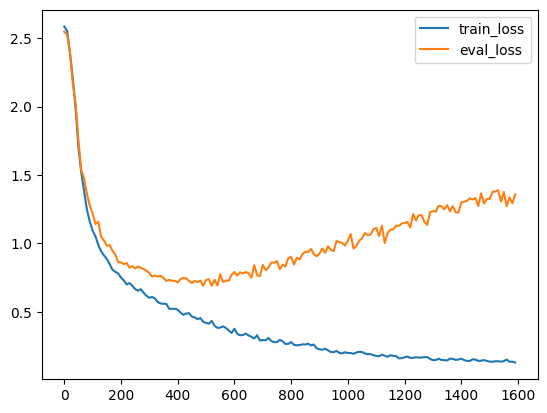

In [14]:
train_loss = pickle.load(open('loss_history.pkl','rb'))
eval_loss = pickle.load(open('eval_loss_history.pkl','rb'))
x = [i * 10 for i in range(len(train_loss))]
plt.plot(x,train_loss,label='train_loss')
plt.plot(x,eval_loss,label='eval_loss')
plt.legend()
plt.show()

We observed that the model converges in approximately 600 steps.

What about other metrics? After our group discussion, we concluded that traditional evaluation metrics such as precision, recall, F1-score, and accuracy may not effectively measure performance in a text-generation task.

Instead, we decided to evaluate the results by our ears. :)

# Generate Songs

Now it’s time to generate some melodies! You can select a model from the options below—we’ve provided two pre-trained models for you to choose from.


In [15]:
# Just trained in the note book
model_path = "model/model_lstm_latest.pth"
char2id_path = "char2id.pkl"
id2char_path = "id2char.pkl"

In [ ]:
# Pretrained on JazzVAR
model_path = "pretrained/jazzvar/model_lstm_latest.pth"
char2id_path = "pretrained/jazzvar/char2id.pkl"
id2char_path = "pretrained/jazzvar/id2char.pkl"
!cp pretrained/jazzvar/note2midi.pkl note2midi.pkl


In [ ]:
# Pretrained on JazzWeb
model_path = "pretrained/jazzweb/model_lstm_latest.pth"
char2id_path = "pretrained/jazzweb/char2id.pkl"
id2char_path = "pretrained/jazzweb/id2char.pkl"
!cp pretrained/jazzweb/note2midi.pkl note2midi.pkl

In [16]:
generator = Generator(char2id_path,id2char_path)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = LSTM(20,512,2,0.5,20)
model.to(device)
model.load_state_dict(torch.load(model_path))
model.eval()
print(model)

LSTM(
  (lstm): LSTM(20, 512, num_layers=2, batch_first=True, dropout=0.5)
  (dropout): Dropout(p=0.5, inplace=False)
  (fc): Linear(in_features=512, out_features=20, bias=True)
)


In [17]:
the_lick = "D3,500,20 E3,500,20 F3,500,20 G3,500,20 E3,500,20 C3,500,20 D3,500,20"
text = generator.generate_song(model,the_lick,1000,5)
print(text)
generator.seq2csv(text,'test.csv')

D3,500,20 E3,500,20 F3,500,20 G3,500,20 E3,500,20 C3,500,20 D3,500,20 C4,1063,377 A3,151,9 B3,303,17 A3,607,33 C4,455,25 G4,911,49 E4,911,49 D4,911,0 A4,245,,25 G4,1367,313 D4,227,0 C4,227,13 D4,227,13 C4,227,13 G4,,911,287 G5,227,13 A4,227,13 G4,227,13 E4,227,13 D41,2271 A4,227,13 E227,13 C#4,,227,13 A#4,227,13 A#4,227,13 B4,227,13 D5,455,25 C5,455,25 A4,911,19 C#4,911,17 A#4,227,13 B4,227,13 D5,227,13 C5,455,25 C5,455,25 C5,922,,455,25 C5,227,13 A4,227,13 54,227,13 A4,227,13 E4,455,25 D#4,22711 D4,227,13 A4,683,37 A4,227,13 E4,227,13 C#4,,227,13 A3,227,13 G#3,227,1A G#4,683,37 G4,227,134,222 ,1,82 GA4,455,25 A5,455,25 C5,9,1,19 C5,455,25 D5,455,25 E5,911,49 C5,227,13 G#4,227,13 A4,227,53 5,247,,21 G5,227,13 45,455,25 C5,227,13 D5,227,13 C5,227,13 A4,227,13 E4,455,25 D#4,227,1 D4,227,13 A#4,55,35 A4,27,13 D4,227,13 E4,455,25 G4,227,13 G4,911,289 G4,22,,13 44,227,13 G4,22,,13 41,227,13 E4,455,25 B4,227,13 B4,227,13 C5,227,13 D4,227,13 C4,227,13 D5,227,13 C5,227,13 G4,227,13 G4,227,13 G

You might notice that some sequences do not perfectly fit the expected structure, such as "C#12,123,321." No worries—our script will automatically filter out these sequences.

In [18]:
# Convert the csv back  to midi file
!csvmidi test.csv test.mid

<ipython-input-6-18f400e92ad4>:4: UserWarning: Frequency axis exceeds Nyquist. Did you remember to set all spectrogram parameters in specshow?
  librosa.display.specshow(pm.get_piano_roll(fs)[start_pitch:end_pitch],


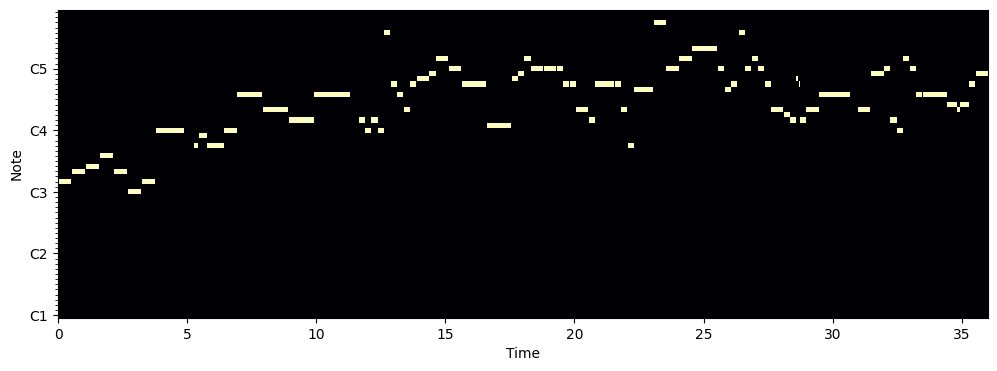

In [19]:
pm = pretty_midi.PrettyMIDI('test.mid')
plt.figure(figsize=(12,4))
plot_piano_roll(pm,24,84)

In [21]:
fs = FluidSynth()
fs.midi_to_audio('test.mid',"test.wav")
Audio("test.wav")

# How about Chat GPT?
We were also curious about how well GPT performs, so we asked it to generate some sequences.

For our initial attempt, we used a very simple prompt.
```
Now you are a jazz music generator. Give me 1000 length sequnces based on
D3,500,20 E3 500,20 F3 500,20
```
And here’s what the generated music looks like—just a simple scale ascending and descending. Quite boring.

In [ ]:
fs = FluidSynth()
fs.midi_to_audio('gpt.mid',"gpt.wav")
Audio("gpt.wav")

Then, we used a more concise prompt to see what it would generate for us.
```
Now you are a jazz music generator.
Give me 1000 length sequnces based on D3,500,20 E3 500,20 F3 500,20
The sequence should be a Charlie Parker, Bebop style and sequence should be used the II-V-I-VI chord progression.
```

In [ ]:
fs = FluidSynth()
fs.midi_to_audio('gpt_bebop.mid',"gpt_bebop.wav")
Audio("gpt_bebop.wav")

GPT seems to understand how to use related scales within the chord and even adds some passing tones to make the melody more interesting. However, it still primarily generates simple scale patterns moving up and down. It’s far from true music—more like a practice routine or a repetitive lick.

# What's next
Okay, we have to admit—the generated melody sounds like a drunk musician! But at least it understands how to to create tension and occasionally produces some decent licks.

Maybe jazz is simply too complex for an LSTM to learn effectively. Jazz musicians frequently play outside the key, improvise, and re-arrange melodies, making the music less structured and more challenging to model.

Perhaps training on simple songs from a specific musician within a well-defined style could yield better results. Who knows?
